# Extract Mechanisms from Space

## Setup Environment

In [1]:
import os
import numpy as np
import pandas as pd

import scanpy as sc
import squidpy as sq
import liana as li
import matplotlib.pyplot as plt

In [2]:
import sys
sys.path.append(os.path.join('..', 'spot_calling'))
from utils import load_prep_slide

In [3]:
data_dir = os.path.join('..', '..', 'data', 'heart_visium')

In [4]:
dataset_names = [f for f in os.listdir(data_dir) if f.endswith('.h5ad')]

In [5]:
metadata = pd.read_csv(os.path.join("..", "spot_calling", "visium_meta.csv"))

## Process Datasets

In [6]:
lrdatas = {}

In [7]:
for dataset_name in dataset_names:
    print(f"dataset_name: {dataset_name}")
    adata = load_prep_slide(data_dir, dataset_name, add_sample_name=True)
    
    li.ut.spatial_neighbors(adata, bandwidth=150, set_diag=True, cutoff=0.05)
    
    adata.write_h5ad(os.path.join('results', 'processed', dataset_name))

    li.mt.lr_bivar(adata,
                    function_name='cosine',
                    expr_prop=0.1,
                    n_perms=None,
                    use_raw=False,
                    add_categories=False,
                    )
    lrdata = adata.obsm['local_scores']
    
    print(f"lrdata shape: {lrdata.shape}")

    lrdatas[dataset_name] = lrdata


dataset_name: AKK001_157785.h5ad
lrdata shape: (3082, 500)
dataset_name: AKK002_157779.h5ad
lrdata shape: (3771, 674)
dataset_name: AKK002_157781.h5ad
lrdata shape: (4659, 651)
dataset_name: AKK002_157782.h5ad
lrdata shape: (2994, 739)
dataset_name: AKK003_157775.h5ad
lrdata shape: (4200, 601)
dataset_name: AKK003_157777.h5ad
lrdata shape: (3373, 498)
dataset_name: AKK004_157772.h5ad
lrdata shape: (4104, 217)
dataset_name: AKK006_157771.h5ad
lrdata shape: (4267, 374)
dataset_name: Visium_10_CK288.h5ad
lrdata shape: (3388, 384)
dataset_name: Visium_11_CK289.h5ad
lrdata shape: (1857, 679)
dataset_name: Visium_12_CK290.h5ad
lrdata shape: (3173, 490)
dataset_name: Visium_13_CK291.h5ad
lrdata shape: (2494, 362)
dataset_name: Visium_14_CK292.h5ad
lrdata shape: (3084, 416)
dataset_name: Visium_15_CK293.h5ad
lrdata shape: (2679, 732)
dataset_name: Visium_16_CK294.h5ad
lrdata shape: (2406, 350)
dataset_name: Visium_17_CK295.h5ad
lrdata shape: (3484, 582)
dataset_name: Visium_18_CK296.h5ad
lrdat

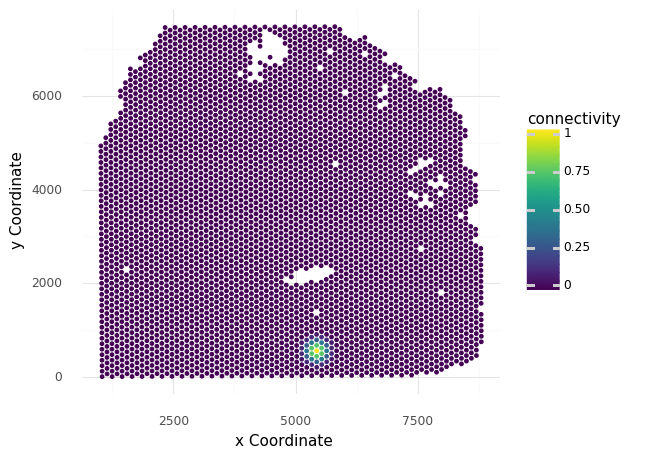

<ggplot: (8736179534984)>

In [8]:
li.pl.connectivity(adata, idx=5)

## Run NMF on the whole Dataset

In [9]:
features = pd.concat([lrdatas[dataset_name].var for dataset_name in lrdatas])
features['count'] = 1 
features = features.reset_index().groupby('interaction').sum().sort_values('count')

<AxesSubplot:>

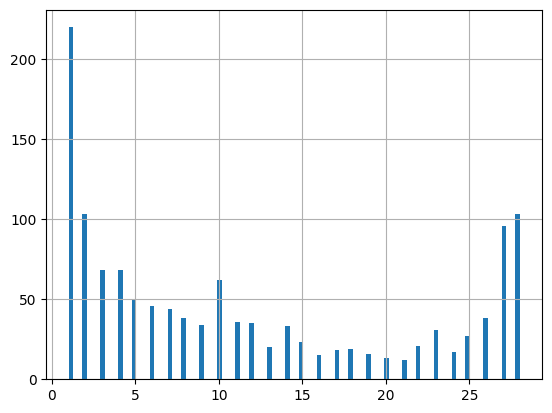

In [10]:
features['count'].hist(bins=100)

Keep features in at least 10 samples (~1/3rds of the datasets)

In [11]:
features = features[features['count'] >= 10]

In [12]:
features.index

Index(['PGF^NRP2', 'ST6GAL1^EGFR', 'LAMA2^ITGA3_ITGB1', 'CCN2^EGFR',
       'COL4A2^ITGA3_ITGB1', 'TGFB1^TGFBR1_TGFBR2', 'PLAU^PLAUR',
       'LAMA4^ITGA3_ITGB1', 'CXCL12^CXCR4', 'MIF^EGFR',
       ...
       'PSAP^LRP1', 'COL4A2^CD93', 'COL1A2^CD93', 'TGM2^ITGB1', 'COL1A2^CD36',
       'COL1A1^ITGA5', 'COL1A1^CD93', 'COL1A1^CD36', 'COL4A1^CD93',
       'A2M^LRP1'],
      dtype='object', name='interaction', length=635)

In [13]:
lrdata_all = sc.concat(lrdatas, join='outer', fill_value=0)

In [14]:
lrdata_all

AnnData object with n_obs × n_vars = 91205 × 1306
    obs: 'in_tissue', 'array_row', 'array_col', 'sample', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'mt_frac', 'celltype_niche', 'molecular_niche', 'n_genes'
    obsm: 'compositions', 'mt', 'spatial'

In [15]:
# subset to features found in at least 10 datasets
lrdata_all = lrdata_all[:, features.index]

In [16]:
lrdata_all

View of AnnData object with n_obs × n_vars = 91205 × 635
    obs: 'in_tissue', 'array_row', 'array_col', 'sample', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'mt_frac', 'celltype_niche', 'molecular_niche', 'n_genes'
    obsm: 'compositions', 'mt', 'spatial'

## Run NMF

100%|██████████| 9/9 [05:29<00:00, 36.61s/it]


Estimated rank: 3


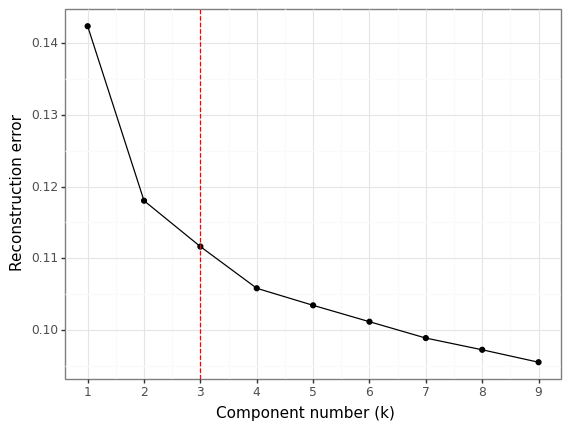

In [17]:
li.multi.nmf(lrdata_all, n_components=None, inplace=True, random_state=1337, max_iter=400, verbose=True)

Check loadings

In [18]:
lr_loadings = li.ut.get_variable_loadings(lrdata_all, varm_key='NMF_H').set_index('index')

In [19]:
lr_loadings.columns

Index(['Factor1', 'Factor2', 'Factor3'], dtype='object')

In [20]:
max_w = lrdata_all.obsm['NMF_W'].max()

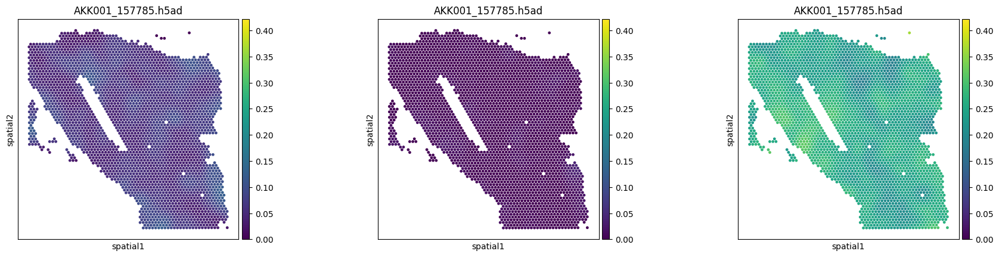

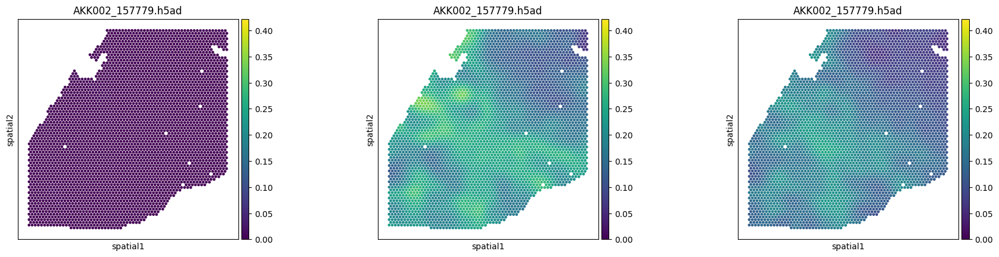

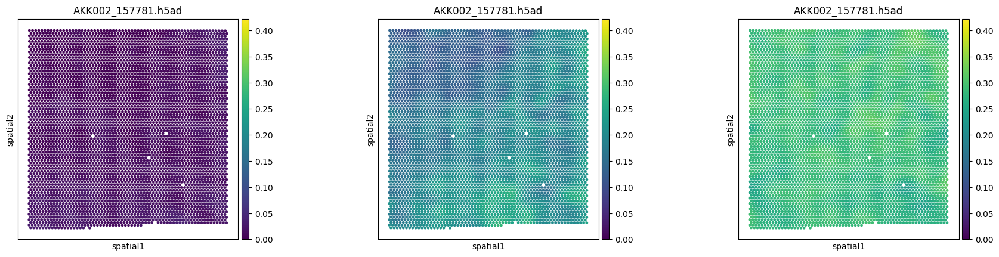

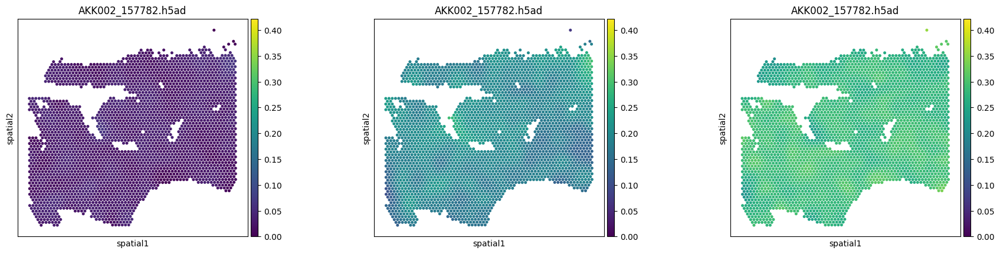

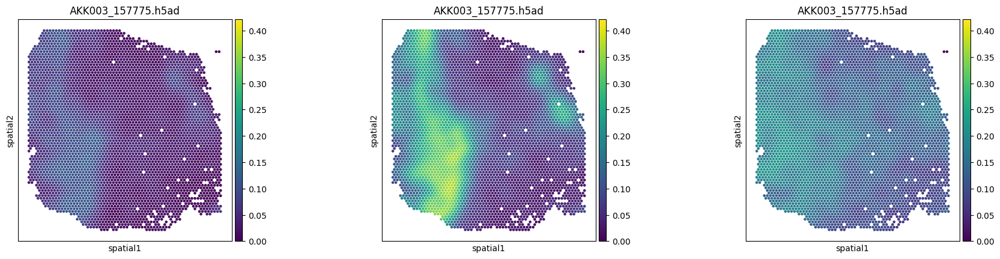

...

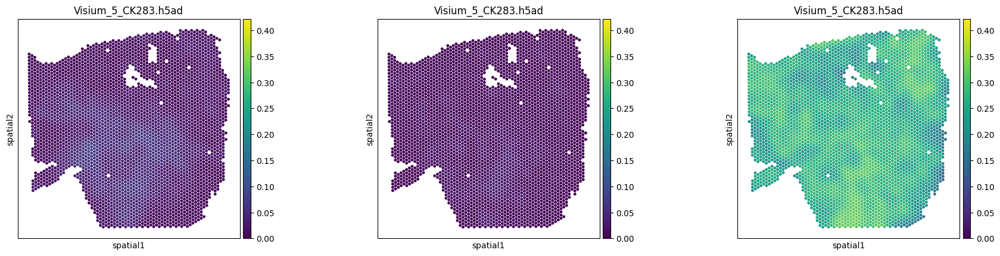

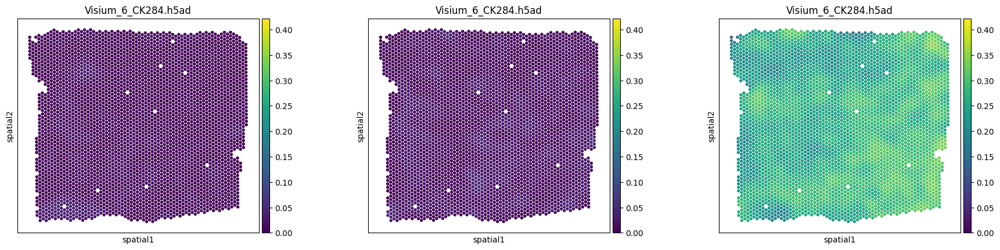

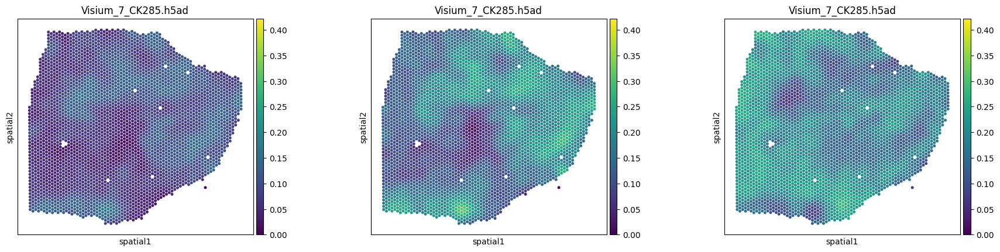

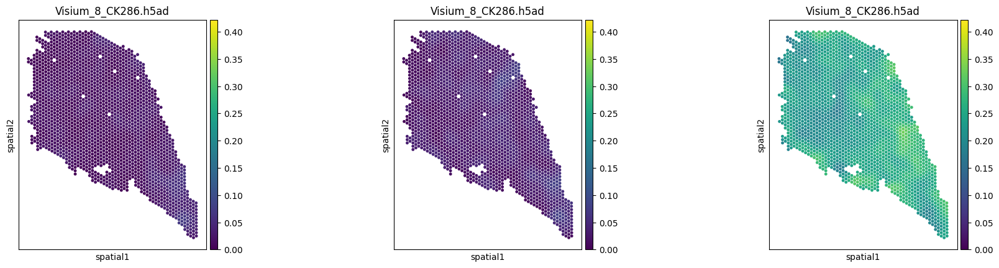

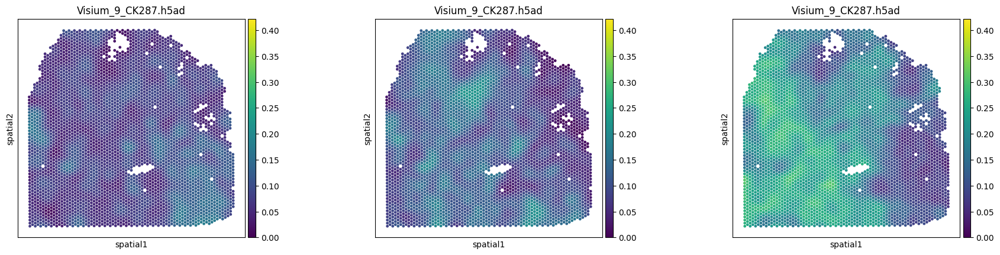

In [21]:
# transfer the NMF factors to the individual samples
for sample in lrdatas:
    # each
    lrdata = lrdatas[sample]
    
    # save to folder
    lrdata.write_h5ad(os.path.join('results', 'lr', sample))
    
    # Get the NMF factors for the current sample from the full dataset
    temp = lrdata_all[lrdata_all.obs.index.isin(lrdata.obs.index), :]
    temp = temp[:, temp.var.index.isin(lrdata.var.index)]
    
    # extract NMF from obsm
    ad_nmf = sc.AnnData(X=temp.obsm['NMF_W'],
                        obs=temp.obs,
                        var=pd.DataFrame(index=lr_loadings.columns),
                        uns=lrdata.uns,
                        obsm={'spatial':temp.obsm['spatial']}
                        )

    ad_nmf.write_h5ad(os.path.join('results', 'nmf', sample))
    
    # plot
    sq.pl.spatial_scatter(ad_nmf, color=lr_loadings.columns, cmap='viridis', title=sample, vmax=max_w, vmin=0, size=1.4, img=False) #
    plt.show() 

### Analyse Loadings

In [22]:
nmfdata = sc.AnnData(X=lrdata_all.obsm['NMF_W'],
                     obs=lrdata_all.obs,
                     var=pd.DataFrame(index=lr_loadings.columns),
                     uns=lrdata_all.uns,
                     obsm={'spatial':lrdata_all.obsm['spatial']}
                     )

In [23]:
indices = lrdata_all.obs.index
nmfdata.obs = nmfdata.obs.merge(metadata, left_on='sample', right_on='slide_name')
nmfdata.obs.index = indices

/home/dbdimitrov/anaconda3/envs/spiana/lib/python3.10/site-packages/anndata/_core/anndata.py:798: UserWarning: 
AnnData expects .obs.index to contain strings, but got values like:
    [0, 1, 2, 3, 4]

    Inferred to be: integer



Averages per slide

In [24]:
import decoupler as dc

In [25]:
import seaborn as sns

In [26]:
nmfbulk = dc.get_pseudobulk(nmfdata,
                            sample_col='hca_sample_id',
                            groups_col=None, mode='mean',
                            skip_checks=True, min_cells=0,
                            min_counts=0, min_prop=None,
                            min_smpls=None
                            )

In [27]:
rename_dict = {'group_1': 'Myogenic \n (n=14)', 'group_2':'Ischemic \n (n=9)', 'group_3': 'Fibrotic \n (n=5)'}
nmfbulk.obs['patient_group'] = nmfbulk.obs['patient_group'].map(rename_dict)


In [28]:
group_annotations = nmfbulk.obs['patient_group'].values

In [29]:
group_labels = set(group_annotations)

In [30]:
group_labels

{'Fibrotic \n (n=5)', 'Ischemic \n (n=9)', 'Myogenic \n (n=14)'}

In [31]:
# import colour map Dark2 from seaborn
cmap = sns.color_palette('Dark2', n_colors=len(group_labels))

In [32]:
# get cmap values for each group annotation as hex
group_cmap = dict(zip(group_labels, cmap))

In [33]:
group_cols = [group_cmap[key] for key in group_labels]

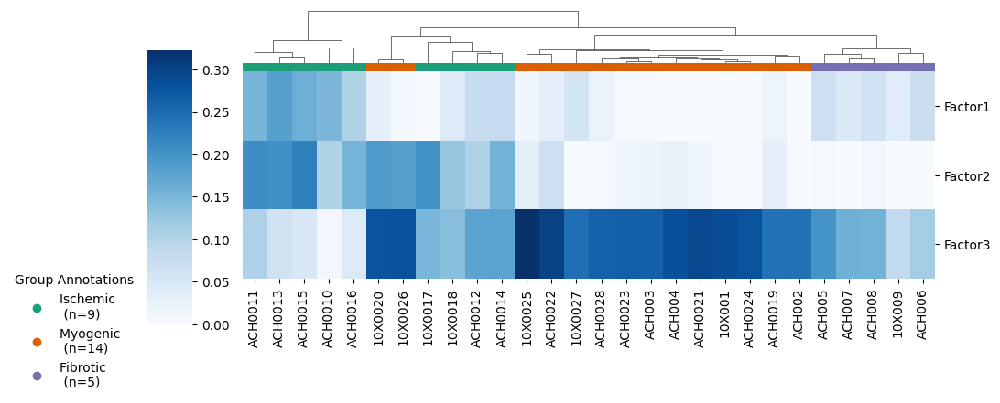

In [34]:
chart = sns.clustermap(nmfbulk.X.T,
                       cmap='Blues',
                       cbar_kws={'orientation':'vertical'},
                       row_cluster=False, col_cluster=True,
                       col_colors=[group_cmap[x] for x in group_annotations],
                       # change size
                       figsize=(10, 4),
                       # add x axis label
                       xticklabels=nmfbulk.obs.index,
                       yticklabels=nmfbulk.var.index,
                       cbar_pos=(0.1, 0.1, 0.05, 0.75)
                       )
# rotate labels
chart.ax_heatmap.set_yticklabels(chart.ax_heatmap.get_ymajorticklabels(), rotation=0)
colorbar = chart.ax_col_colors.collections[0].colorbar

# Create custom legend
legend_handles = []
for label, color in zip(group_labels, group_cols):
    legend_handles.append(plt.Line2D([0], [0], color=color, marker='o', linestyle='', label=label))

# Add legend
legend = plt.legend(handles=legend_handles, title='Group Annotations', loc='upper right', frameon=False)

# Move the legend
chart_size = chart.ax_heatmap.get_position()
plt.setp(legend.get_title(), fontsize='medium')  # Set the font size of the legend title
legend.set_bbox_to_anchor((chart_size.x1 - 1, chart_size.y0))  # Adjust the position of the legend
plt.show()

Two factors associated with Ischemic: Factor1 and Factor4; Factor2 healthy; Factor 3 kinda mixed

In [35]:
nmfdata.obs[['hca_sample_id', 'patient', 'sample']].drop_duplicates()

,hca_sample_id,patient,sample
AKK001_157785-AAACAAGTATCTCCCA-1,10X0027,P5,AKK001_157785
AKK002_157779-AAACAAGTATCTCCCA-1,10X0017,P3,AKK002_157779
AKK002_157781-AAACAACGAATAGTTC-1,10X0026,P3,AKK002_157781
AKK002_157782-AAACAAGTATCTCCCA-1,10X0020,P3,AKK002_157782
AKK003_157775-AAACAACGAATAGTTC-1,10X0018,P2,AKK003_157775
AKK003_157777-AAACAAGTATCTCCCA-1,10X0025,P2,AKK003_157777
AKK004_157772-AAACAACGAATAGTTC-1,10X009,P4,AKK004_157772
AKK006_157771-AAACAAGTATCTCCCA-1,10X001,P1,AKK006_157771
Visium_10_CK288-AAACAAGTATCTCCCA-1,ACH0024,P12,Visium_10_CK288
Visium_11_CK289-AAACAAGTATCTCCCA-1,ACH0010,P13,Visium_11_CK289


### Pathway Enrichment

In [36]:
import plotnine as p9
# fdr adjust pvals
from statsmodels.stats.multitest import fdrcorrection as fdr

In [37]:
lr_nmf = pd.DataFrame(lrdata_all.varm['NMF_H'], index=lrdata_all.var.index, columns=lr_loadings.columns)

In [38]:
lr_nmf.to_csv(os.path.join('results', 'lr_loadings.csv'))

In [39]:
lr_nmf.sort_values("Factor1", ascending=False).head(5)

,Factor1,Factor2,Factor3
CCN2^LRP1,4.895369,0.030555,1.258049
LUM^ITGB1,4.846434,0.052287,2.280240
APOE^LRP1,4.739762,0.277341,0.929298
SERPING1^LRP1,4.532526,0.120519,1.897571
PSAP^LRP1,4.436368,0.416325,2.241719


In [40]:
# load PROGENy pathways
net = dc.get_progeny(organism='human', top=5000)
# load full list of ligand-receptor pairs
lr_pairs = li.resource.select_resource('consensus')


/home/dbdimitrov/anaconda3/envs/spiana/lib/python3.10/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html


In [41]:
# generate ligand-receptor geneset
lr_progeny = li.rs.generate_lr_geneset(lr_pairs, net, lr_separator="^")
lr_progeny.head()

,source,interaction,weight
1,JAK-STAT,LGALS9^PTPRC,1.307807
74,Androgen,SEMA4D^MET,-0.831693
90,Androgen,HGF^MET,-1.288956
106,Androgen,TIMP3^MET,-1.122612
151,NFkB,SELE^CD44,3.332552


In [42]:
# run pathway enrichment analysis
estimate, pvals =  dc.run_ulm(lr_nmf.transpose(),
                              lr_progeny,
                              source="source", target="interaction",
                              use_raw=False, min_n=5)
# pivot columns to long
estimate = (estimate.
            melt(ignore_index=False, value_name='estimate', var_name='pathway').
            reset_index().
            rename(columns={'index':'factor'})
            )
# pivot columns to long
pvals = (pvals.
            melt(ignore_index=False, value_name='pval', var_name='pathway').
            reset_index().
            rename(columns={'index':'factor'})
        )

In [43]:
dc_res = estimate.merge(pvals, on=['factor', 'pathway']).copy()

In [44]:
dc_res.loc[dc_res['estimate'] >= 5, 'estimate'] = 5

In [45]:
dc_res['adj_pval'] = fdr(dc_res['pval'])[1]

In [46]:
dc_res.sort_values('adj_pval').head()

,factor,pathway,estimate,pval,adj_pval
24,Factor1,TGFb,5.000000,2.112660e-10,8.873170e-09
16,Factor2,MAPK,4.746243,2.564173e-06,5.384764e-05
18,Factor1,NFkB,-4.515420,7.537503e-06,1.055250e-04
28,Factor2,TNFa,4.445764,1.034197e-05,1.085907e-04
4,Factor2,EGFR,4.292786,2.041099e-05,1.714523e-04


In [47]:
# assign * if adj_pval < 0.05
dc_res['significant'] = dc_res['adj_pval'].apply(lambda x: '*' if x < 0.05 else '')

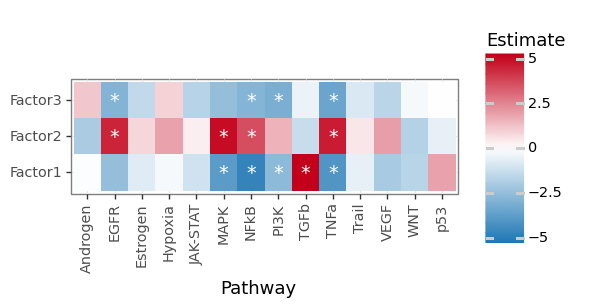

<ggplot: (8736179825301)>

In [48]:
## p9 tile plot
(p9.ggplot(dc_res) +
 p9.aes(x='pathway', y='factor') +
 p9.geom_tile(p9.aes(fill='estimate')) +
 # geom text significant
 p9.geom_text(p9.aes(label='significant'), size=14, color='white', fontstyle='oblique') +
 p9.theme_bw(base_size=13) +
 p9.theme(figure_size=(5, 1.5), axis_text_x=p9.element_text(angle=90)) +
 # max 5 and min -5
 p9.scale_fill_gradient2(low='#1f77b4', high='#c20019', limits=(-5, 5)) +
 p9.labs(x='Pathway', y='', fill='Estimate')
)

Explore loadings x PROGENy, for a specific view

In [49]:
# pivot to long
lr_loadings = lr_nmf.melt(ignore_index=False, value_name='loading', var_name='factor').reset_index()

In [50]:
lr_loadings.rename(columns={'index':'interaction'}, inplace=True)

In [51]:
lr_loadings

,interaction,factor,loading
0,PGF^NRP2,Factor1,0.782198
1,ST6GAL1^EGFR,Factor1,0.691128
2,LAMA2^ITGA3_ITGB1,Factor1,0.000000
3,CCN2^EGFR,Factor1,1.674985
4,COL4A2^ITGA3_ITGB1,Factor1,0.000000
...,...,...,...
1900,COL1A1^ITGA5,Factor3,1.029477
1901,COL1A1^CD93,Factor3,1.128982
1902,COL1A1^CD36,Factor3,1.985597
1903,COL4A1^CD93,Factor3,1.362857


In [52]:
lr_loadings = lr_loadings.merge(lr_progeny.rename(columns={"source":"pathway"}), left_on='interaction', right_on='interaction', how='left').dropna()

In [53]:
lr_loadings['sign'] = lr_loadings['weight'].apply(lambda x: 'positive' if x > 0 else 'negative')

In [54]:
lr_loadings['relevant_interactions'] = lr_loadings.apply(lambda x: x['interaction'] if (np.abs(x['loading']) > 0.3) and (np.abs(x['weight']) >= 2) else None, axis=1)

In [55]:
selected_pathway = 'MAPK'
selected_view = 'Factor2'

In [56]:
data = lr_loadings[(lr_loadings['pathway']==selected_pathway) & (lr_loadings['factor']==selected_view)].copy()

/home/dbdimitrov/anaconda3/envs/spiana/lib/python3.10/site-packages/plotnine/layer.py:411: PlotnineWarning: geom_label : Removed 39 rows containing missing values.


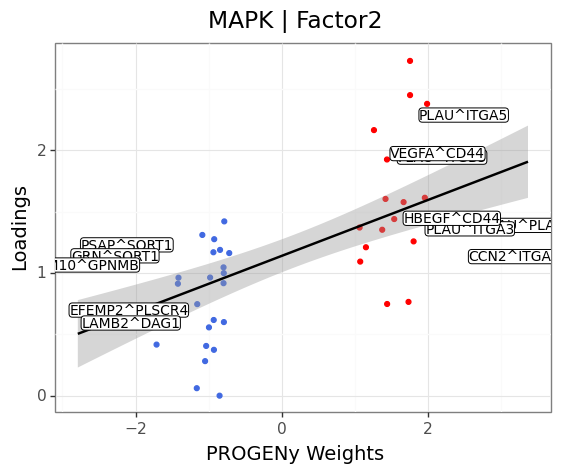

<ggplot: (8736220496878)>

In [57]:

(
    p9.ggplot(data) +
    p9.aes(x='weight', y='loading') +
    p9.geom_point(p9.aes( colour='sign')) +
    p9.theme(legend_position='none') +
    p9.labs(title="{} | {}".format(selected_pathway, selected_view), x="PROGENy Weights", y="Loadings") +
    p9.geom_smooth(method='lm') +
    p9.theme_bw(base_size=14) +
    p9.scale_colour_manual(values=["royalblue", "red"]) +
    p9.geom_label(p9.aes(label='relevant_interactions'), size=10, nudge_y=0.01, nudge_x=0.01, label_padding=0.01) +
    # p9.xlim(-3, 3) +
    p9.guides(colour=False)
)